In [1]:
#!pip install librosa

# FEATURE EXTRACTION

In [2]:
import pandas as pd
import numpy as np 
import os

import matplotlib.pyplot as plt

import librosa
import librosa.display

import seaborn as sns
sns.set_style("whitegrid")

import math

import warnings
warnings.filterwarnings("ignore")

import IPython

import sklearn

C:\Users\Priyanka Pai\anaconda3\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [8]:
os.chdir(r"C:\Users\Priyanka Pai\Desktop\FINAL PROJECT\Data")
path_audio_files = "genres_original/"

In [9]:

# Meaning of each of these....
frame_size = 1024
hop_length = 512
n_fft = 2048

genre_dict = {"blues":0, "classical":1, "country":2, "disco":3, "hiphop":4,
              "jazz":5, "metal":6, "pop":7, "reggae":8, "rock":9}

# Reading Audio Files

In [10]:
for genre in genre_dict.keys():
    print(genre)
    # Reading the first audio file
    data, sampling_rate = librosa.load(path_audio_files + genre +"/" + genre + ".00000.wav")
    
    display(IPython.display.Audio(data, rate = sampling_rate))

blues


classical


country


disco


hiphop


jazz


metal


pop


reggae


rock


# Visualizing Audio Files

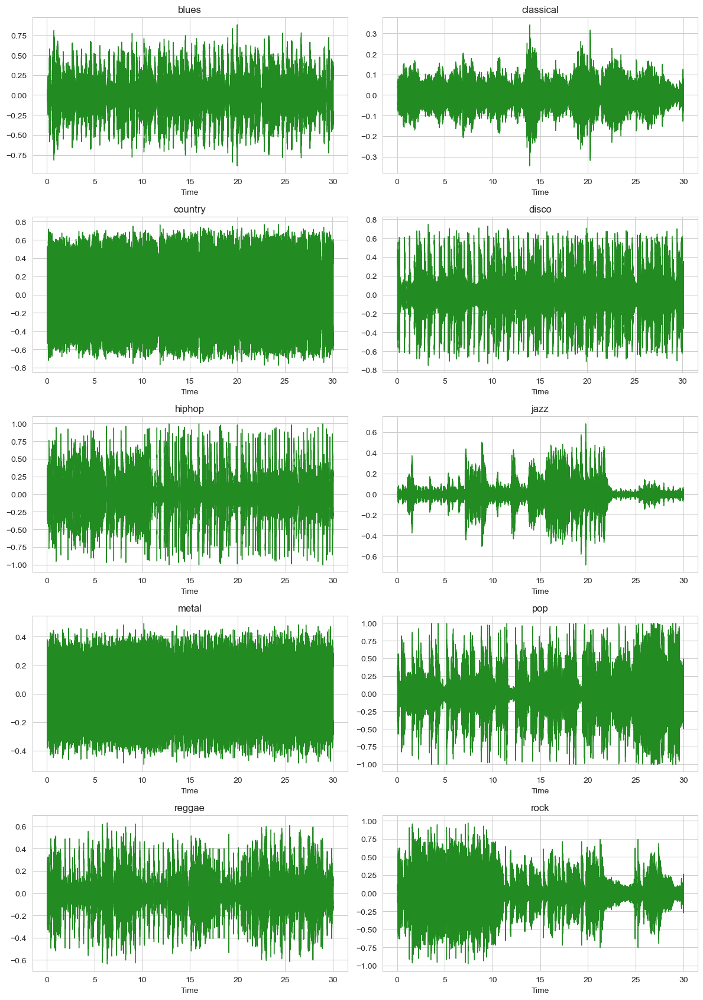

In [11]:
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(12,17))
i=0
j=0

for genre in genre_dict.keys():
    # Reading the audio files
    data, sampling_rate = librosa.load(path_audio_files + genre +"/" + genre + ".00000.wav")
    
    librosa.display.waveshow(y=data, sr=sampling_rate, color="#228B22", ax=axes[i][j])
    
    axes[i][j].set_title(genre)
    
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1
    
    
plt.tight_layout()
plt.show()

# Zero Crossing Rate
The zero crossing rate indicates the number of times that a signal crosses the horizontal axis

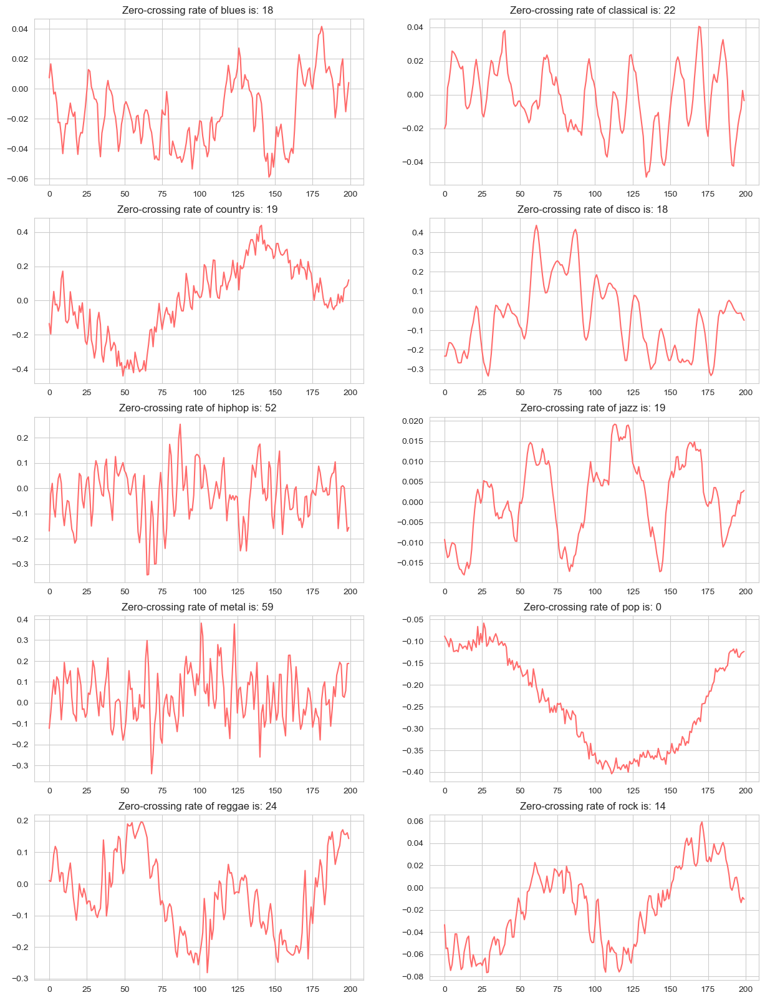

In [12]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
start = 0
end = 200
for genre in genre_dict.keys():
    
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    #zero_crossing_rate = librosa.feature.zero_crossing_rate(y = data[start:end],hop_length = hop_length)[0]
    zero_cross_rate = librosa.zero_crossings(data[start:end], pad=False)
    #print("The number of zero crossings is:",sum(zero_cross_rate))
    axes[i][j].plot(data[start:end],color = "#FF6A6A")
 
    axes[i][j].set_title("Zero-crossing rate of {} is: {} ".format(genre,sum(zero_cross_rate)))

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

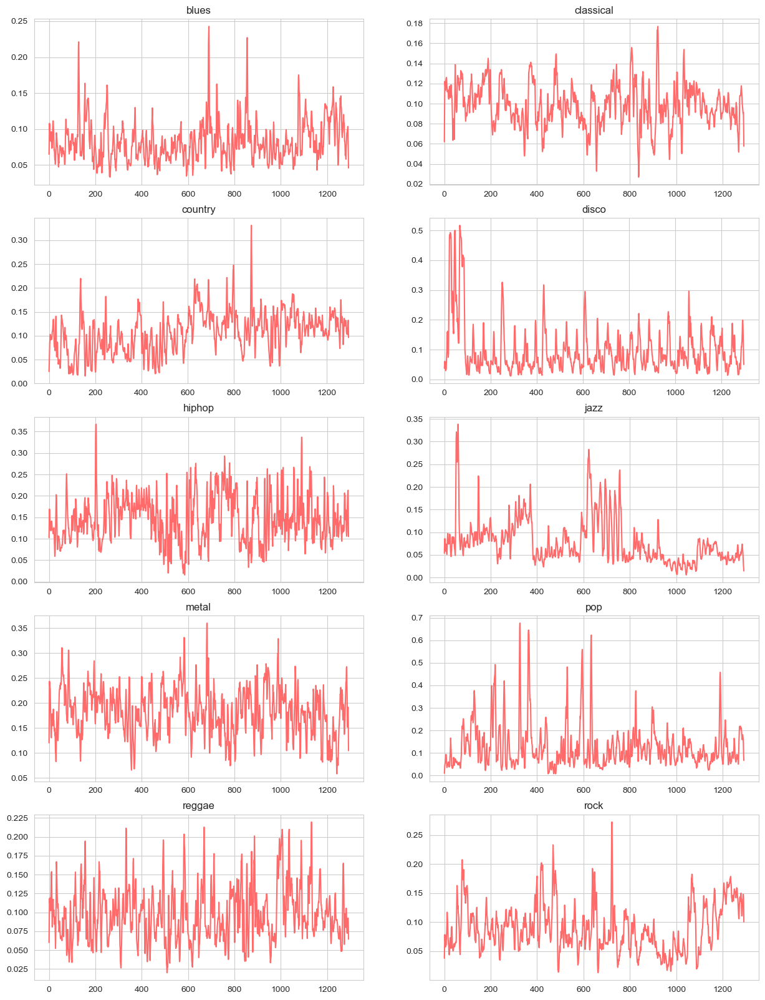

In [13]:

fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    zero_crossing_rate = librosa.feature.zero_crossing_rate(y = data,hop_length = hop_length)[0]
    
    axes[i][j].plot(zero_crossing_rate,color = "#FF6A6A")
 
    axes[i][j].set_title(genre)

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

In [39]:
zero_cross_rate = librosa.zero_crossings(data[start:end], pad=False)
print("The number of zero crossings is:",sum(zero_cross_rate))

The number of zero crossings is: 14


In [40]:
start = 1000
end = 1200
for genre in genre_dict.keys():
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    zero_cross_rate = librosa.zero_crossings(y=data[start:end], pad=False)
    print("The number of zero crossings for", genre, "is:", sum(zero_cross_rate))

The number of zero crossings for blues is: 21
The number of zero crossings for classical is: 27
The number of zero crossings for country is: 8
The number of zero crossings for disco is: 11
The number of zero crossings for hiphop is: 32
The number of zero crossings for jazz is: 15
The number of zero crossings for metal is: 47
The number of zero crossings for pop is: 7
The number of zero crossings for reggae is: 21
The number of zero crossings for rock is: 14


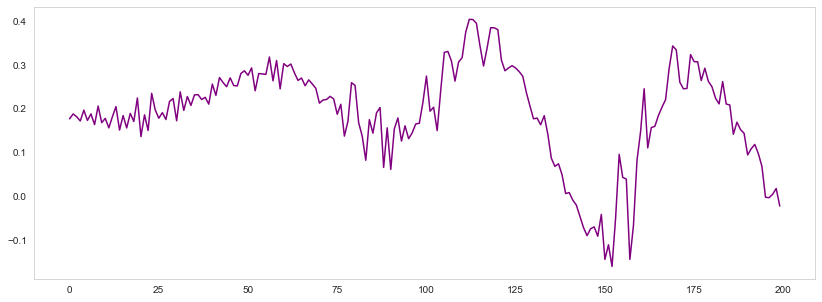

In [41]:
data,sampling_rate = librosa.load(path_audio_files + "pop" + "/" + "pop" + ".00000.wav")
#zero_cross_rate = librosa.feature.zero_crossing_rate(y=data[start:end], pad=False)
start = 1000
end = 1200
plt.figure(figsize=(14,5))
plt.plot(data[start:end], color='Purple')
plt.grid()

# Spectogram
A Spectogram represents the intensity of a signal over time at various frequencies

Time on x-axis and Intensity of Frequency on y-axis

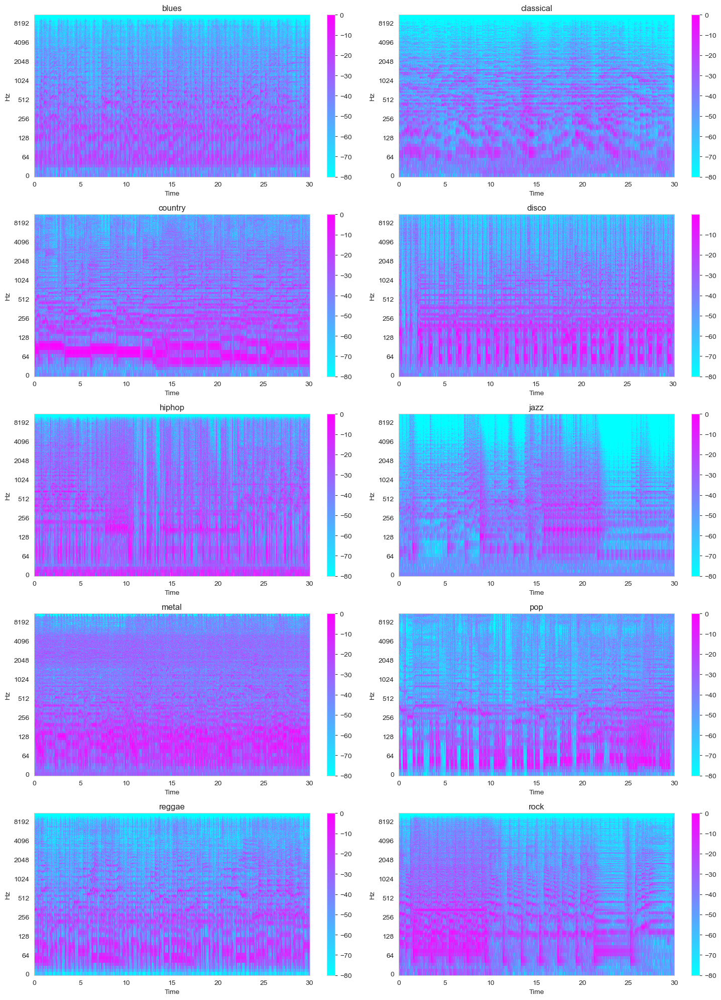

In [15]:
fig, axes = plt.subplots(nrows = 5, ncols = 2, figsize = (15,20))
i=0
j=0
for genre in genre_dict.keys():
    data, sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    stft_data = np.abs(librosa.stft(y = data, n_fft = n_fft, hop_length = hop_length))
    DB = librosa.amplitude_to_db(stft_data, ref = np.max)
    img = librosa.display.specshow(DB, sr = sampling_rate, hop_length = hop_length, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=axes[i][j])
    fig.colorbar(img, ax=axes[i][j])
    
    axes[i][j].set_title(genre)

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

# Mel Spetogram
The Mel Scale is a logarithmic transformation of a signal’s frequency. The core idea of this transformation is that sounds of equal distance on the Mel Scale are perceived to be of equal distance to humans. Hence, it mimics our own perception of sound.

The transformation of frequency to mel scale is:  
m
=
1127
∗
l
n
(
1
+
f
/
700
)
 
Mel Spectrograms are spectrograms that visualize sounds on the Mel scale as opposed to the frequency domain

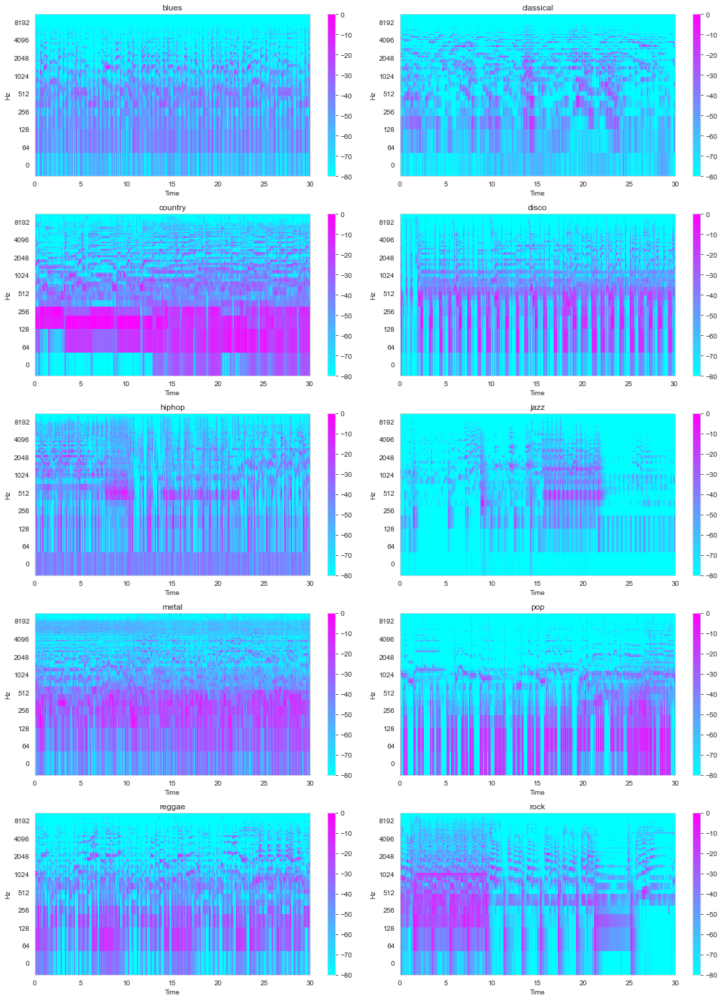

In [44]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    mel_spec = librosa.feature.melspectrogram(data, sr=sampling_rate,hop_length = hop_length)
    
    mel_spec_db = librosa.amplitude_to_db(mel_spec, ref=np.max)

    img = librosa.display.specshow(mel_spec_db, sr = sampling_rate, hop_length = hop_length, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=axes[i][j])
    fig.colorbar(img, ax=axes[i][j])
    
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

# Mel Frequency Cepstral Coefficients
MFCCs are commonly derived as follows:

1. Convert Hertz to mel-scale
2. Take logarithm of Mel representation of audio
3. Take the discrete cosine transform of the list of mel log powers, as if it were a signal.
4. The MFCCs are the amplitudes of the resulting spectrum.

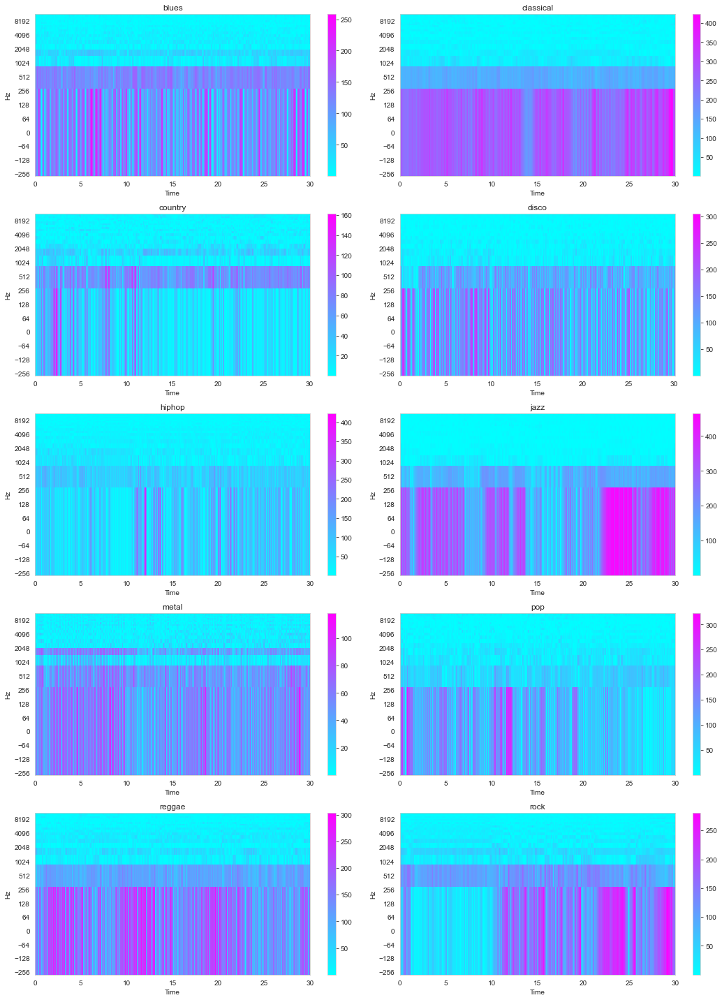

In [45]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    mfcc_data = np.abs(librosa.feature.mfcc(data, sr = sampling_rate))
    
    img = librosa.display.specshow(mfcc_data, sr = sampling_rate, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=axes[i][j])
    fig.colorbar(img, ax=axes[i][j])
    
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

# CHROMAGRAM
Shifting the time window across the music representation results in a sequence of chroma features each expressing how the representation's pitch content within the time window is spread over the twelve chroma bands. The resulting time-chroma representation is also referred to as chromagram.

    C, C♯, D, D♯, E , F, F♯, G, G♯, A, A♯, B

Interpretation:
   * Color ranges from Red(presence of the pitch/chroma feature) to Blue (absence of the pitch or chroma feature)
   * For **Country**, it is centred around **F#**. While for **Blues**, it is highly **scattered and distributed**

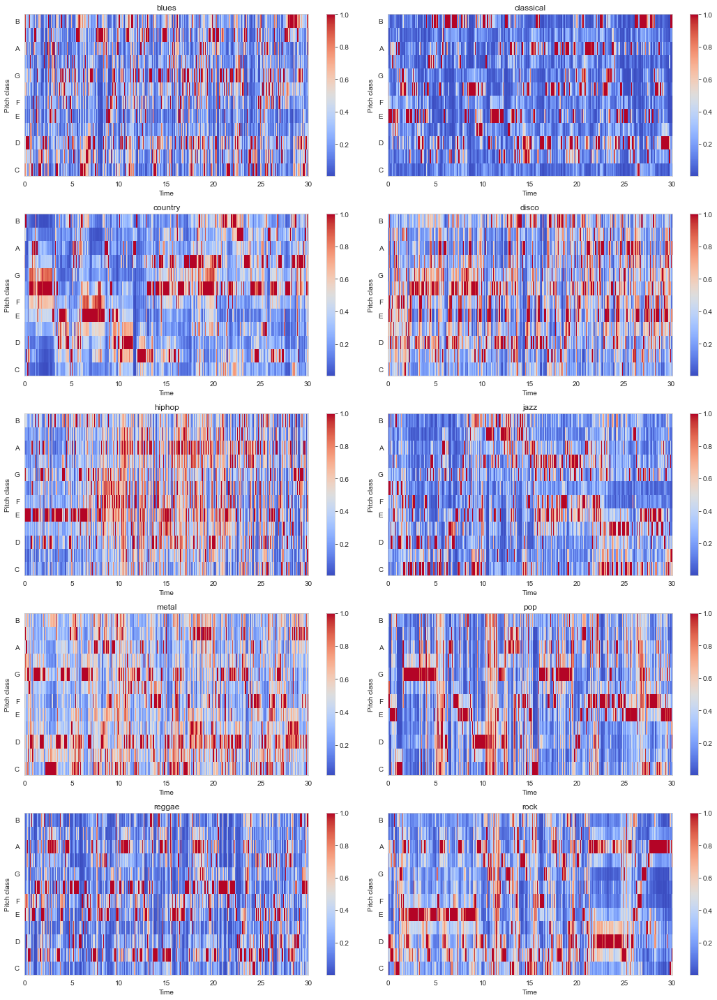

In [55]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    # Chromogram
    chromagram = librosa.feature.chroma_stft(data, sr=sampling_rate, hop_length=hop_length)
    #print('Chromogram shape:', chromagram.shape)

    #plt.figure(figsize=(16, 6))
    img = librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm',ax=axes[i][j])
    fig.colorbar(img, ax=axes[i][j])
    axes[i][j].set_title(genre)

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

# SPECTRAL CENTROIDS
Spectral Centroids indicates where the center of mass of the spectrum is located. Perceptually, it has a robust connection with the impression of brightness of a sound.

The spectral centroid is a good predictor of the "brightness" of a sound, it is widely used in digital audio and music processing as an automatic measure of musical timbre (tone color or tone quality)

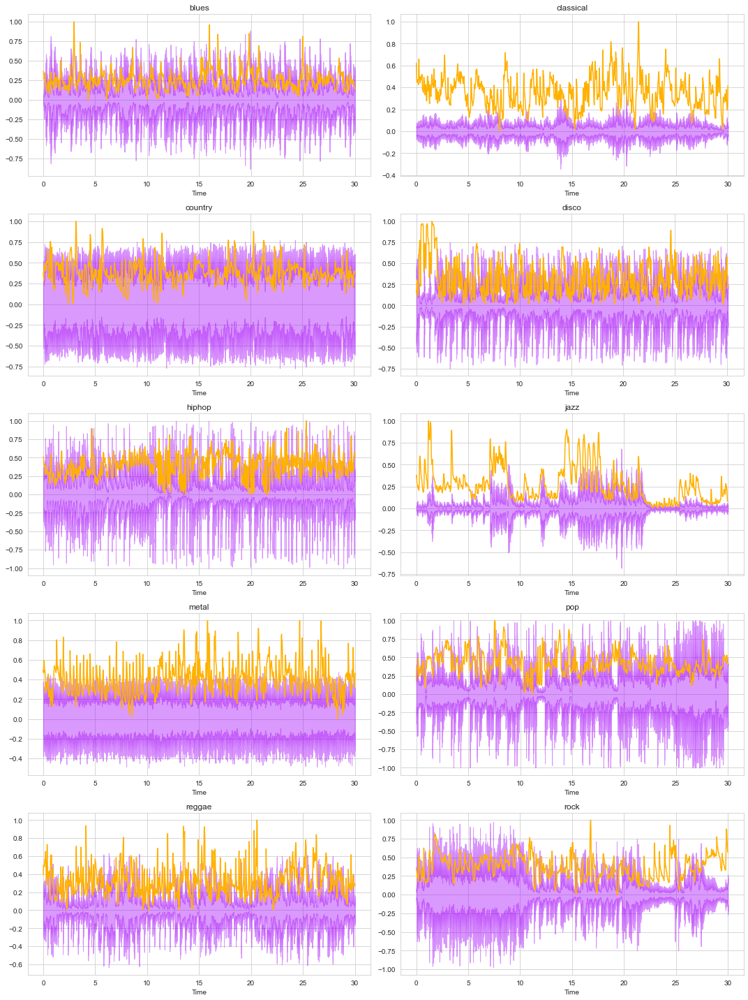

In [47]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    spectral_centroids = librosa.feature.spectral_centroid(y=data, sr=sampling_rate)[0]
    
    # Computing the time variable for visualization
    frames = range(len(spectral_centroids))

    # Converts frame counts to time (seconds)
    t = librosa.frames_to_time(frames)
    
    librosa.display.waveshow(data, sr=sampling_rate, alpha=0.4, color = '#A300F9',ax=axes[i][j])

    axes[i][j].plot(t, sklearn.preprocessing.minmax_scale(spectral_centroids, axis=0), color='#FFB100')
    axes[i][j].set_title(genre)

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

# Tempo and Beats
Beat is a regular repeating pulse that underly a musical pattern.

Tempo means the speed at which a piece of music should be played. It is measured in Beats per minute

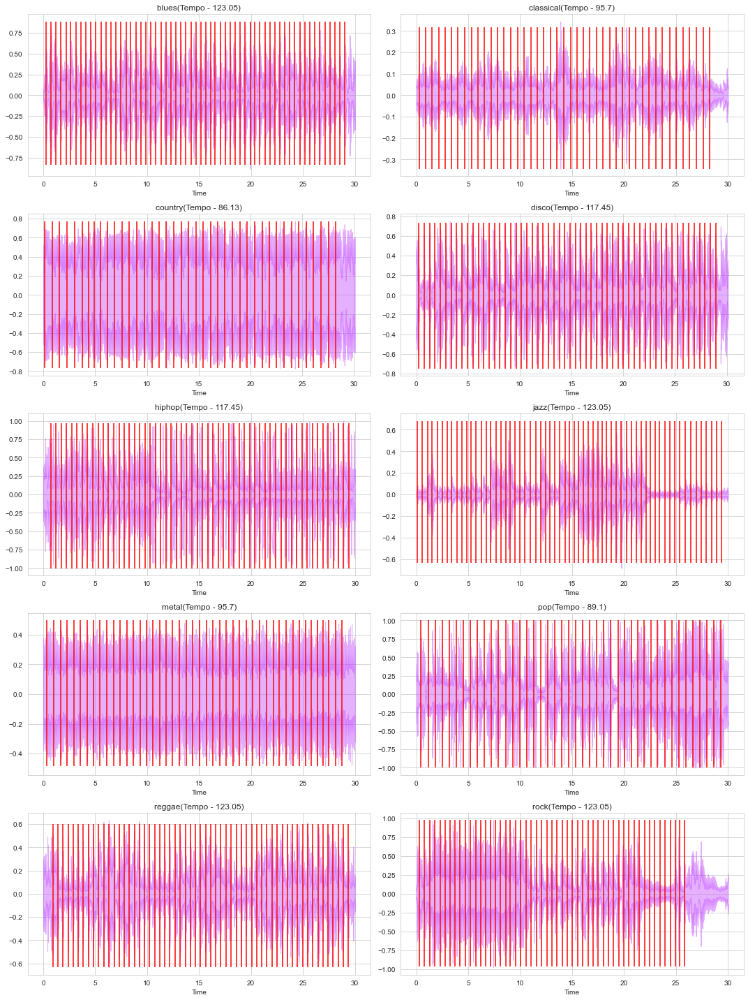

In [53]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    tempo, beat_times = librosa.beat.beat_track(y=data, sr=sampling_rate, units='time')

    librosa.display.waveshow(y = data, sr = sampling_rate, color = "#BF3EFF",alpha = 0.4,ax=axes[i][j])
    
    axes[i][j].vlines(beat_times, np.min(data), np.max(data), color='r')  # red line represents the beats
    
    axes[i][j].set_title(genre + "(Tempo - " + str(round(tempo,2)) + ")")
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

# Spectral Rolloff
Spectral rolloff is the frequency below which a specified percentage of the total spectral energy, e.g. 85%, lies. 

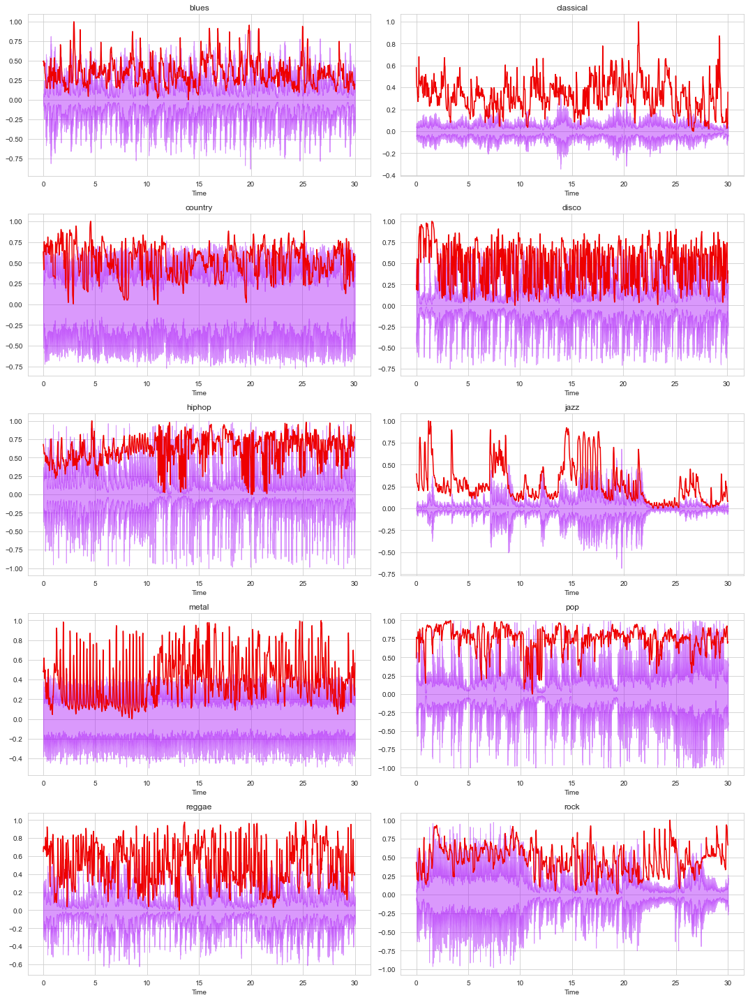

In [49]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    spectral_rolloff = librosa.feature.spectral_rolloff(data, sr=sampling_rate)[0]
    
    # Computing the time variable for visualization
    frames = range(len(spectral_rolloff))

    # Converts frame counts to time (seconds)
    t = librosa.frames_to_time(frames)
    
    librosa.display.waveshow(data, sr=sampling_rate, alpha=0.4, color = '#A300F9',ax=axes[i][j])

    axes[i][j].plot(t, sklearn.preprocessing.minmax_scale(spectral_rolloff, axis=0), color='#EE0000')
    axes[i][j].set_title(genre)

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

# Harmonic and Percussive Components
Harmonic sound on the one hand side is what we perceive as pitched sound and what makes us hear melodies and chords. 

Percussive sound on the other hand is noise-like and usually stems from instrument onsets like the hit on a drum or from consonants in speech.

Interpretation:
   * For **Classical**, the frequency of the harmonic component is greater than the percussive component.
   * For **Hiphop**, the frequency of the harmonic component is less than the percussive component.

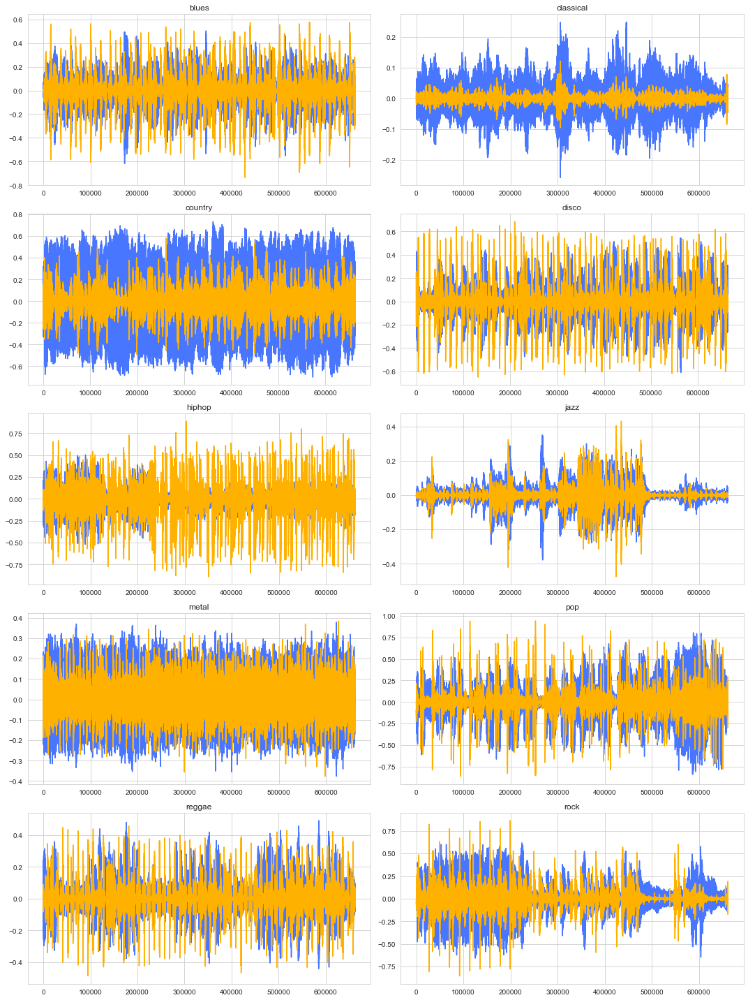

In [56]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    y_harm, y_perc = librosa.effects.hpss(data)
    
    axes[i][j].plot(y_harm, color = '#4876FF')  # Harmonic component is represented as blue
    
    axes[i][j].plot(y_perc, color = '#FFB100')  # Percussive component is represented as yellow
    
    axes[i][j].set_title(genre)

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1
        
plt.tight_layout()
plt.show()